<a href="https://colab.research.google.com/github/kmurdzek/Trajectory-Replanning/blob/main/trajectoryReplanning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import colors as c
import matplotlib as mpl
import sys
import random
from heapq import heappush, heappop, heapify, nsmallest
from collections import deque
import matplotlib.colors as mcolors
import timeit

In [ ]:
def generate_mazes( num_of_mazes, num_of_rows, num_of_cols):
  mazes = np.zeros((num_of_mazes, num_of_rows, num_of_cols), dtype=int)
  mazes.fill(3)
  #starting at a random vertex pick mark it as visited and unblocked, select a random neighbor to visit thats not yet visited
  #the neighbor has a 30% probabilty of being blocked and 70% of being unblocked
  #a cell that has no unvisited neighbors is a deadend -> then go back to parent node, until it reaches a node with unvisited neighbors
  #if the stack is empty, repeat the process from a node that has not yet been visited
  
  visited = set() #set that will hold the visited indexes
  stack = []
  row_new, col_new = 0,0
  deadend = False
  while(len(visited) < num_of_rows * num_of_cols): #run the following until all nodes are visited
    #select random point to start
    row, col = random.randint(0,num_of_rows-1), random.randint(0,num_of_cols-1)
    while((row,col) in visited): #if we got here it means we got blocked in and had to find a new starting point
      row, col = random.randint(0,num_of_rows-1), random.randint(0,num_of_cols-1) #generate random points until were somewhere we havent visited
    
    stack.append((row,col)) #add starting position into the stack
    mazes[0][row][col] = 3 #set starting position to unblocked
    visited.add((row,col)) #add the starting position to the visited set
    while(len(stack)>0): #run as long as theres elements in the
      row,col = stack[-1] #get index at top of stack
      #print("Top of the stack when polled: ", row, col)
      direction_x, direction_y = random.randint(-1,1), random.randint(-1,1)
      row_new = row + direction_x
      col_new = col + direction_y
      #print("To be validated Node", row_new, col_new)
      if (not isValid(row_new, col_new, num_of_rows, num_of_cols) or (row_new,col_new) in visited):
        #if the node is not valid or it was visited already, check if its parent led us to a deadend
        deadend, row, col = isDeadEnd(row, col, visited, num_of_rows, num_of_cols)
        #if deadend is false we move onto the new row and new col we received from deadend 
        #function which is a neighbor of the parent node, new row and new col are valid
        if deadend:
          stack.pop(); #means we visited all the nodes neighbors remove it from stack
          #what happens if we hit a straight up dead end? we have to run it back
          #to the parent node and try a new random neighbor
          #print("popped because of deadend")
        else:
          #this else means that the node was not a deadend we just didn't find it 
          #randomly. row and col equal a valid neighbor of the node being observed
          probability = random.randint(0,10)
          #print("HOW ", probability)
          if probability <= 3:
            #node is blocked/ made a wall
            mazes[0][row][col] = 1
            visited.add((row,col))
          else:
            #node is unblocked add to stack  /made a path
            stack.append((row,col))
            #print("Node added to stack in not valid: ", row , col)
            visited.add((row,col))
      elif isValid(row_new, col_new, num_of_rows, num_of_cols):
        row, col = row_new, col_new #new values were valid so we set them to our row and col
        #print("VALID")
        #if the node is valid and not already visited
        probability = random.randint(0,10)
        if probability <= 3 :
            #node is blocked
          mazes[0][row][col] = 1
          visited.add((row,col))
        else:
            #node is unblocked add to stack 
          stack.append((row,col))
          #print("Node added to stack in valid ", row , col)
          visited.add((row,col))
          
      #print(row, col)
  picture_maze(mazes)
  return mazes
    


In [ ]:
def picture_maze(mazes):
    #print("Maze : ", 1,"\n", mazes[0])
    color_list = ['w', 'k', 'b', 'g', 'r', 'c', 'm', 'y']
    cmap = c.ListedColormap(color_list)
    bounds = range(7 + 2)
    norm = c.BoundaryNorm(bounds, cmap.N)

    plt.axis('off')
    im = plt.pcolor(mazes[0][::-1], cmap=cmap, norm=norm, edgecolors = "k", animated = True)
    plt.show()

In [ ]:
def isValid(row, col, num_of_rows, num_of_cols):
  if row < 0 or row >= num_of_rows or col < 0 or col >= num_of_cols:
    return False
  else :
    return True

In [ ]:
def isDeadEnd(row, col, visited, num_of_rows, num_of_cols):
  if(isValid(row+1, col, num_of_rows, num_of_cols) and (row+1,col) not in visited):
    return False, row+1, col
  if(isValid(row-1, col, num_of_rows, num_of_cols) and (row-1,col) not in visited):
    return False, row-1, col
  if(isValid(row, col+1, num_of_rows, num_of_cols) and (row,col+1) not in visited):
    return False, row, col+1
  if(isValid(row, col-1, num_of_rows, num_of_cols) and (row,col-1) not in visited):
    return False, row, col-1
  return True, -1, -1

In [ ]:
def see_neighbors(x, y, mazes, state):
  rows, cols = mazes.shape
  state[x][y] = mazes[x][y] #makes sure we know the state were in
  if state[x][y] == 1:
    return
  if x + 1 >= 0 and x + 1 < rows and y >= 0 and y < cols:
    state[x+1][y] = mazes[x+1][y]
  if x-1 >= 0 and x-1 < rows and y >= 0 and y < cols:
    state[x-1][y] = mazes[x-1][y]
  if x >= 0 and x < rows and y-1 >= 0 and y-1 < cols:
    state[x][y-1] = mazes[x][y-1]
  if x >= 0 and x < rows and y+1 >= 0 and y+1 < cols:
    state[x][y+1] = mazes[x][y+1]

Maze being traversed



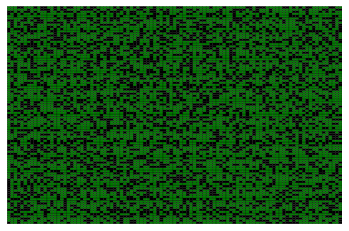

not valid starting configuration
not valid starting configuration
not valid starting configuration
not valid starting configuration
not valid starting configuration
not valid starting configuration
not valid starting configuration
Repeated Forward Break ties to higher g(x) start


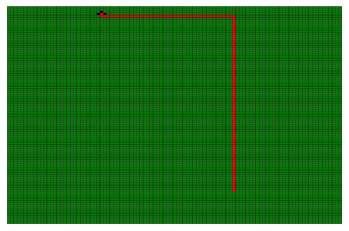

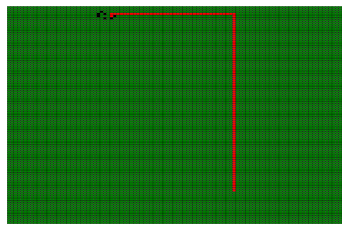

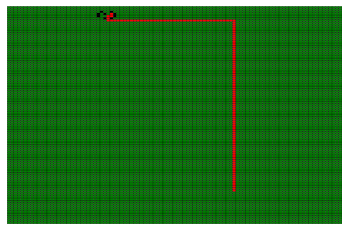

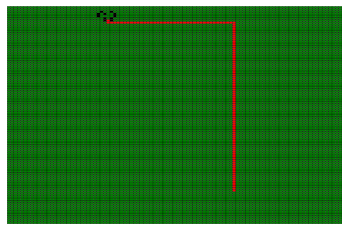

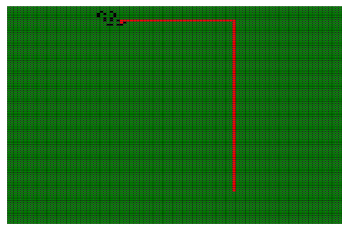

...

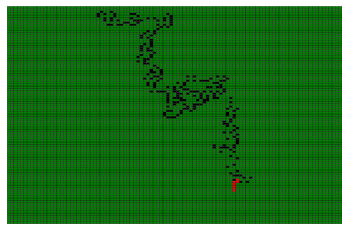

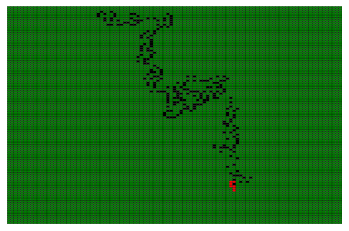

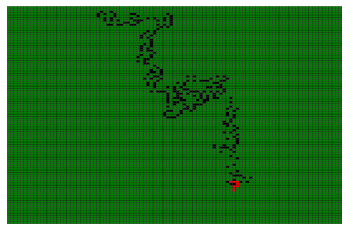

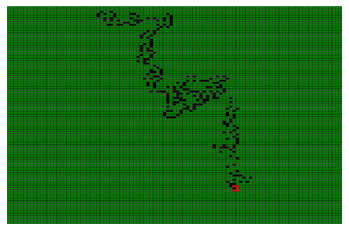

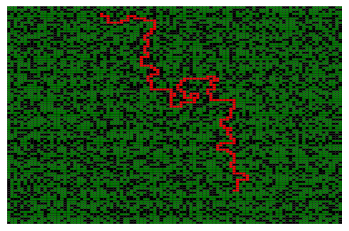

Repeated Forward Break ties to higher g(x) end

Repeated Forward Break ties to lower g(x) start
Repeated Forward Break ties to lower g(x) end

Repeated Backwards start


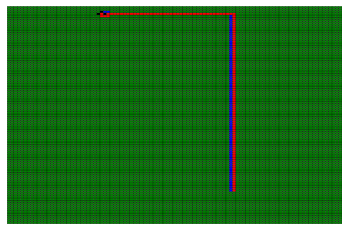

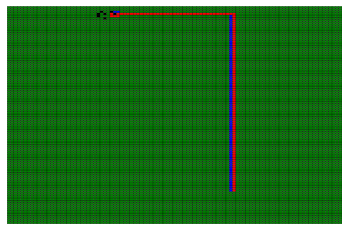

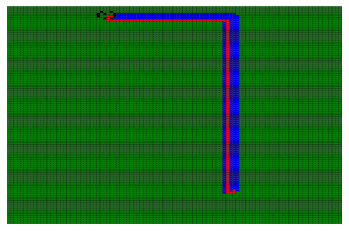

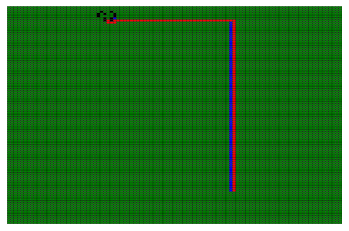

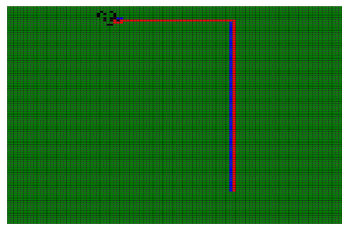

...

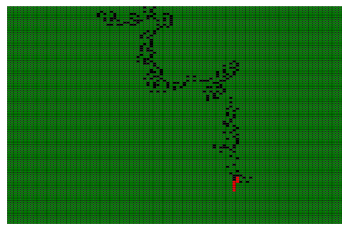

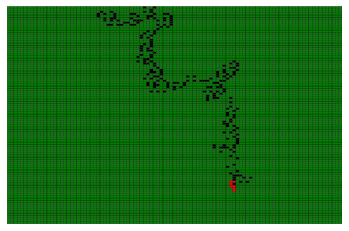

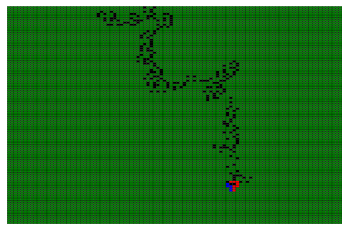

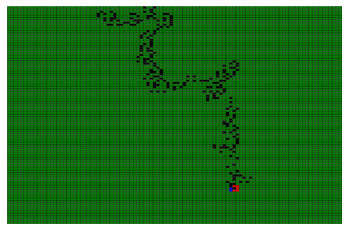

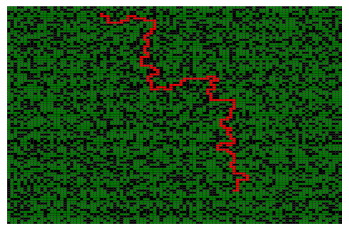

Repeated Backwards end

Adaptive A start


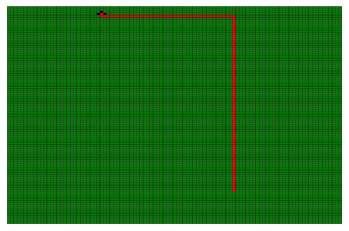

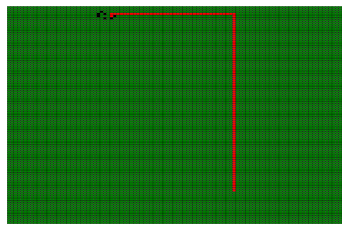

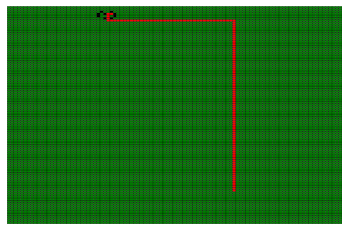

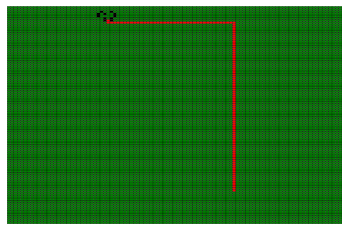

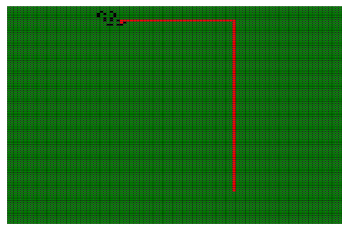

...

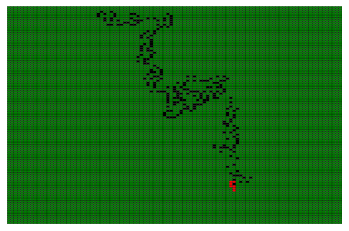

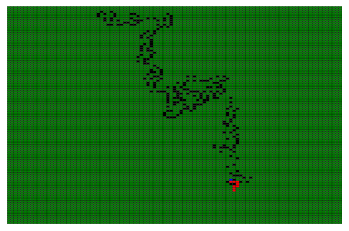

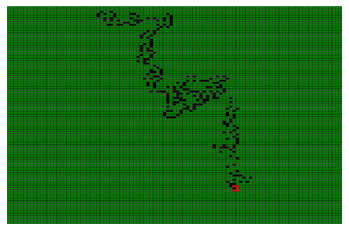

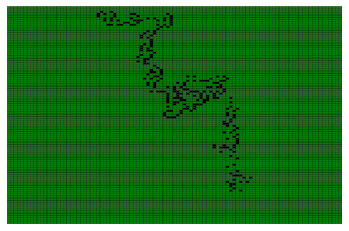

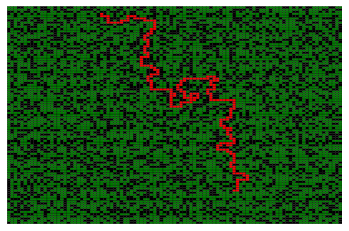

Adaptive A end

Repeated Forward average (breaks ties to higher g)
  29.699384320000036  sec
 Repeated Forward average (breaks ties to lower g)
 0.0006235440000637027  sec 
 Repeated Backwards average
  33.28752067400001  sec
 Adaptive average
  38.22301425699993  sec


In [ ]:
if __name__ == '__main__':
  '''
  When running the main method mazes will appear as the A* variations begin to run
  every maze that appears is a state of the current a* search in which the final 
  path is generated. Green represents open cells, Red represents the path taken,
  Blue represents visited nodes. 

  Note: Repated A* that breaks ties to lower g values runs extremely slow if it 
  encounters obstacles, comment the call to repeated_forward_break_ties_to_lower_g
  out if you want the operations to complete in a reasonable time. 
  repeated_forward_break_ties_to_lower_g method expands the shortest distance from the
  start node therefore it usually traverses the whole maze which affects runtime extremely.
  '''
  time_sum_forward = 0
  time_sum_forward_ties = 0
  time_sum_backwards = 0
  time_sum_adaptive = 0
  size_of_maze = 101
  iterations = 1
  for i in range(iterations):
    print('Maze being traversed\n')
    mazes = generate_mazes(1, size_of_maze,size_of_maze)
    start_x, start_y, goal_x, goal_y = random.randint(0,size_of_maze-1),random.randint(0,size_of_maze-1),random.randint(0,size_of_maze-1),random.randint(0,size_of_maze-1)
    maze_for_backwards = mazes.copy()
    maze_for_forwards = mazes.copy()
    maze_for_adaptive = mazes.copy()
    maze_for_forward_2 = mazes.copy()
    while(mazes[0][start_x][start_y]==1 or mazes[0][goal_x][goal_y]==1):
      print('not valid starting configuration')
      start_x, start_y, goal_x, goal_y = random.randint(0,size_of_maze-1),random.randint(0,size_of_maze-1),random.randint(0,size_of_maze-1),random.randint(0,size_of_maze-1)
    start = timeit.default_timer()
    print("Repeated Forward Break ties to higher g(x) start")
    repeated_forward(start_x, start_y, goal_x, goal_y,maze_for_forwards,size_of_maze)
    print("Repeated Forward Break ties to higher g(x) end\n")
    stop =  timeit.default_timer()

    start2 = timeit.default_timer()
    print("Repeated Forward Break ties to lower g(x) start")
    #repeated_forward_break_ties_to_lower_g(start_x,start_y,goal_x,goal_y, maze_for_forward_2,size_of_maze)
    print("Repeated Forward Break ties to lower g(x) end\n")
    stop2 =  timeit.default_timer()

    start3 = timeit.default_timer()
    print("Repeated Backwards start")
    repeated_backwards(start_x, start_y, goal_x, goal_y,maze_for_backwards,size_of_maze)
    print("Repeated Backwards end\n")
    stop3 = timeit.default_timer()

    start4 = timeit.default_timer()
    print("Adaptive A start")
    adaptive_a(start_x,start_y,goal_x,goal_y, maze_for_adaptive,size_of_maze)
    print("Adaptive A end\n")
    stop4 = timeit.default_timer()
    time_sum_forward += stop-start
    time_sum_forward_ties += stop2-start2
    time_sum_backwards += stop3-start3
    time_sum_adaptive += stop4-start4

  print('Repeated Forward average (breaks ties to higher g)\n ', time_sum_forward/iterations,' sec\n','Repeated Forward average (breaks ties to lower g)\n' 
        , time_sum_forward_ties/iterations,' sec \n',
        'Repeated Backwards average\n ', time_sum_backwards/iterations,' sec\n','Adaptive average\n ', time_sum_adaptive/iterations, ' sec')
      

In [ ]:
def repeated_forward(start_x, start_y, goal_x, goal_y, mazes,size):
  '''
  At the start state expand look whats to the left, right, above and below the cell.
  This is all that we know about the whole maze
  '''
  current_state = np.zeros((1,size,size),dtype=int)#makes a maze that replicates state of the agent
  current_state.fill(3) #fills the array with 3's, 3= unblocked 1= blocked
  #see_neighbors function takes the starting location and sets the cells right next to it to either blocked or unblocked
  see_neighbors(start_x, start_y, mazes[0], current_state[0]) #updates the current state and shows what the agent knows
  maze_state = current_state.copy() # make a copy of the state so we can push it into the heap later
  openList = [] #holds the states and f values for each maze
  current_x, current_y = start_x, start_y
  path_2 = {} #holds the path that the agent takes
  path_2[(start_x,start_y)] = (-2,-2) #marks the start of the path
  expense = 0 #expense is updated everytime we run a* dont know what its for tho
  step_count = 0 #step count is the number of steps on a path agent takes
  #so we have a heap with the f(x) and the state 
  heappush(openList, (manhattan_distance(current_x, current_y, goal_x, goal_y), (current_x, current_y), maze_state,step_count)) #pushing into our heap the current state and values associated with it
  previous_cell = (-1,-1) #this is just a place holder, we set the previous cell in the loop
  while(current_x != goal_x or current_y != goal_y):
    #were going to move along the direction we know
    current_agent = current_state # holds the maze that the agent knows
    #do an astar on current state
    #print("Computed path using A* on agent\n", current_agent)
    #pop whatever has the smallest f(x) from the heap
    if(len(openList)==0): # if theres nothing in the open list theres no path
      print('No valid path')
      return
    #print(len(openList))
    data = heappop(openList) #data is the agent state with the smallest F(x), data in this case is a set that holds our info
    current_x,current_y = data[1][0], data[1][1] #set the current x,y to the x,y that our agent is in
    current_agent = data[2] #current agent is the maze were going to be working on
    step_count = data[3] #amount of steps it took to get there
    path = a_Star(current_x, current_y, goal_x, goal_y, current_agent, size) #path holds the path that was computed on the current state with only what we know
    #from the starting position of the maze
    expense +=1
    #explore the path returned in reverse order
    # if we hit a blockage we need to go back to previous block
    for cell in reversed(path):
      #follow the path as long as the cell were at is not blocked keep going
      #update state for each step we take(basically identifies walls and open path along our walk)
      see_neighbors(cell[0],cell[1], mazes[0], current_agent[0]) #sets the neighboring states
      
      if(current_agent[0][cell[0]][cell[1]] == 1): #means cell is blocked go back to previous state, recompute the path with new knowledge
        maze_state = current_agent.copy() #makes a copy of the current state to be stored in the heap
        heappush(openList, ((manhattan_distance(previous_cell[0],previous_cell[1],goal_x, goal_y)+step_count),previous_cell,maze_state, step_count)) #pushes the new state into the heap
        #print('Sending it back to recompute')
        #picture_maze(maze_state)
        step_count += 1
        break #we followed the path as far as it would let us go back to previous cell, break from the path
      if(cell!=previous_cell): 
        if(cell in path_2): #makes sure to not make another path to a cell where a path already exist
          pass
        else:
          path_2[cell] = (previous_cell) #previous cell is the cells parent, we store it in a dict
      previous_cell = cell
    current_x, current_y = previous_cell[0], previous_cell[1] #sets the current cell to the previous before we got blocked
  #picture_maze(current_agent)
  path_list = []
  temp = (goal_x, goal_y)
  mazes[0][goal_x][goal_y] = 4
  path_list.append(temp)
  i = 0
  while( temp!= (-2,-2) ): #draws the shortest path we computed

    temp = path_2[temp]
    if(temp == (-2,-2)):
      break
    i+=1
    mazes[0][temp[0]][temp[1]] = 4
    path_list.append(temp)
    #print(temp)
  #print('path taken\n')
  #print(path_list)
  picture_maze(mazes)


In [ ]:
def repeated_forward_break_ties_to_lower_g(start_x, start_y, goal_x, goal_y, mazes,size):
  '''
  At the start state expand look whats to the left, right, above and below the cell.
  This is all that we know about the whole maze
  '''
  current_state = np.zeros((1,size,size),dtype=int)#makes a maze that replicates state of the agent
  current_state.fill(3) #fills the array with 3's, 3= unblocked 1= blocked
  #see_neighbors function takes the starting location and sets the cells right next to it to either blocked or unblocked
  see_neighbors(start_x, start_y, mazes[0], current_state[0]) #updates the current state and shows what the agent knows
  maze_state = current_state.copy() # make a copy of the state so we can push it into the heap later
  openList = [] #holds the states and f values for each maze
  current_x, current_y = start_x, start_y
  path_2 = {} #holds the path that the agent takes
  path_2[(start_x,start_y)] = (-2,-2) #marks the start of the path
  expense = 0 #expense is updated everytime we run a* dont know what its for tho
  step_count = 0 #step count is the number of steps on a path agent takes
  #so we have a heap with the f(x) and the state 
  heappush(openList, (manhattan_distance(current_x, current_y, goal_x, goal_y), (current_x, current_y), maze_state,step_count)) #pushing into our heap the current state and values associated with it
  previous_cell = (-1,-1) #this is just a place holder, we set the previous cell in the loop
  while(current_x != goal_x or current_y != goal_y):
    #were going to move along the direction we know
    current_agent = current_state # holds the maze that the agent knows
    expense+=1
    #do an astar on current state
    #print("Computed path using A* on agent\n", current_agent)
    #pop whatever has the smallest f(x) from the heap
    if(len(openList)==0): # if theres nothing in the open list theres no path
      print('No valid path')
      return
    data = heappop(openList) #data is the agent state with the smallest F(x), data in this case is a set that holds our info
    current_x,current_y = data[1][0], data[1][1] #set the current x,y to the x,y that our agent is in
    current_agent = data[2] #current agent is the maze were going to be working on
    step_count = data[3] #amount of steps it took to get there
    path = a_Star_break_ties_to_lower_g(current_x, current_y, goal_x, goal_y, current_agent, size) #path holds the path that was computed on the current state with only what we know
    #from the starting position of the maze
    expense +=1
    #explore the path returned in reverse order
    # if we hit a blockage we need to go back to previous block
    for cell in reversed(path):
      #follow the path as long as the cell were at is not blocked keep going
      #update state for each step we take(basically identifies walls and open path along our walk)
      see_neighbors(cell[0],cell[1], mazes[0], current_agent[0]) #sets the neighboring states
      if(current_agent[0][cell[0]][cell[1]] == 1): #means cell is blocked go back to previous state, recompute the path with new knowledge
        maze_state = current_agent.copy() #makes a copy of the current state to be stored in the heap
        heappush(openList, ((manhattan_distance(previous_cell[0],previous_cell[1],goal_x, goal_y)+step_count),previous_cell,maze_state, step_count)) #pushes the new state into the heap
        #print('Sending it back to recompute')
        picture_maze(maze_state)
        step_count += 1
        break #we followed the path as far as it would let us go back to previous cell, break from the path
      if(cell!=previous_cell): 
        if(cell in path_2): #makes sure to not make another path to a cell where a path already exist
          pass
        else:
          path_2[cell] = (previous_cell) #previous cell is the cells parent, we store it in a dict
      previous_cell = cell
    current_x, current_y = previous_cell[0], previous_cell[1] #sets the current cell to the previous before we got blocked
  picture_maze(current_agent)
  path_list = []
  temp = (goal_x, goal_y)
  mazes[0][goal_x][goal_y] = 4
  path_list.append(temp)
  i = 0
  while( temp!= (-2,-2) ): #draws the shortest path we computed

    temp = path_2[temp]
    if(temp == (-2,-2)):
      break
    i+=1
    mazes[0][temp[0]][temp[1]] = 4
    path_list.append(temp)
    #print(temp)
  #print('path taken\n')
  #print(path_list)
  picture_maze(mazes)


In [ ]:
def adaptive_a(start_x, start_y, goal_x, goal_y, mazes,size):
  '''
  At the start state expand look whats to the left, right, above and below the cell.
  This is all that we know about the whole maze
  '''
  current_state = np.zeros((1,size,size))#makes a maze that replicates state of the agent
  current_state.fill(3) #fills the array with 3's, 3= unblocked 1= blocked
  #see_neighbors function takes the starting location and sets the cells right next to it to either blocked or unblocked
  see_neighbors(start_x, start_y, mazes[0], current_state[0]) #updates the current state and shows what the agent knows
  maze_state = current_state.copy() # make a copy of the state so we can push it into the heap later
  openList = [] #holds the states and f values for each maze
  current_x, current_y = start_x, start_y
  path_2 = {} #holds the path that the agent takes
  path_2[(start_x,start_y)] = (-2,-2) #marks the start of the path
  expense = 0 #expense is updated everytime we run a* dont know what its for tho
  step_count = 0 #step count is the number of steps on a path agent takes
  
  heuristics = np.zeros((1,size,size))
  heuristics.fill(np.inf)
  #so we have a heap with the f(x) and the state 
  heappush(openList, (manhattan_distance(current_x, current_y, goal_x, goal_y), (current_x, current_y), maze_state,step_count)) #pushing into our heap the current state and values associated with it
  previous_cell = (-1,-1) #this is just a place holder, we set the previous cell in the loop
  while(current_x != goal_x or current_y != goal_y):
    #were going to move along the direction we know
    current_agent = current_state # holds the maze that the agent knows
    #do an astar on current state
    #pop whatever has the smallest f(x) from the heap
    if(len(openList)==0): # if theres nothing in the open list theres no path
      print('No valid path')
      return
    data = heappop(openList) #data is the agent state with the smallest F(x), data in this case is a set that holds our info
    current_x,current_y = data[1][0], data[1][1] #set the current x,y to the x,y that our agent is in
    current_agent = data[2] #current agent is the maze were going to be working on
    step_count = data[3] #amount of steps it took to get there
    path = adaptive_a_star_helper(current_x, current_y, goal_x, goal_y, current_agent, size, heuristics[0]) #we want path to return the array of heuristics
    expense +=1
    #explore the path returned in reverse order
    # if we hit a blockage we need to go back to previous block
    for cell in reversed(path):
      #follow the path as long as the cell were at is not blocked keep going
      #update state for each step we take(basically identifies walls and open path along our walk)
      see_neighbors(cell[0],cell[1], mazes[0], current_agent[0]) #sets the neighboring states
      if(current_agent[0][cell[0]][cell[1]] == 1): #means cell is blocked go back to previous state, recompute the path with new knowledge
        maze_state = current_agent.copy() #makes a copy of the current state to be stored in the heap
        heappush(openList, ((manhattan_distance(previous_cell[0],previous_cell[1],goal_x, goal_y)+step_count),previous_cell,maze_state, step_count)) #pushes the new state into the heap
        #print('Sending it back to recompute')
        #picture_maze(maze_state)
        step_count += 1
        break #we followed the path as far as it would let us go back to previous cell, break from the path
      if(cell!=previous_cell): 
        if(cell in path_2): #makes sure to not make another path to a cell where a path already exist
          pass
        else:
          path_2[cell] = (previous_cell) #previous cell is the cells parent, we store it in a dict
      previous_cell = cell
    current_x, current_y = previous_cell[0], previous_cell[1] #sets the current cell to the previous before we got blocked
  picture_maze(current_agent)
  path_list = []
  temp = (goal_x, goal_y)
  mazes[0][goal_x][goal_y] = 4
  path_list.append(temp)
  i = 0
  while( temp!= (-2,-2) ): #draws the shortest path we computed
    temp = path_2[temp]
    if(temp == (-2,-2)):
      break
    i+=1
    mazes[0][temp[0]][temp[1]] = 4
    path_list.append(temp)
    #print(temp)
  #print('path taken\n')
  #print(path_list)
  picture_maze(mazes)

In [ ]:

def adaptive_a_star_helper(start_x, start_y, goal_x, goal_y, mazes1,size, heuristics):
  '''
  Variation of regular a* that keeps track of previous iterations heuristics
  '''
  mazes = mazes1.copy()
  #track the distance to the current node from the start
  distances = np.zeros((size,size),dtype=int)
  distances.fill(np.inf)

  distances[start_x,start_y]= 0
  function_values = np.zeros((size, size), dtype = int)
  prev = 0      #this is for 
  #any move we make we expand the distance by +1 of the parent
  openList = [] #open list heap
  closedList = set()
  path = {}
  path[(start_x, start_y)] = (-1, -1)
  #distance from start + manhattan distance
  value = manhattan_distance(start_x, start_y, goal_x, goal_y)
  heappush(openList, ((value,value), (start_x, start_y)))
  current_x, current_y = start_x, start_y
  path_found = True
  steps_taken = 0
  maxg = size*size
  # how do we know theres no path? when the heap is empty
  #run the loop as long as we are not at the goal 
  while current_x is not goal_x or current_y is not goal_y:
    steps_taken += 1
    if(steps_taken>=maxg):
      print("Path is blocked")
      path_found = False
      break
    node = heappop(openList) #if multiple nodes have same f value break tie with smallest h value
    #pop every node with the same value choose the node with the smallest g
    #expand the node, then put it in the closed list
    closedList.add((node[1][0],node[1][1]))
    current_x = node[1][0]
    current_y = node[1][1]
    mazes[0][current_x][current_y] = 2
    neighbs = get_Neighbors(current_x, current_y ,mazes[0], size)
    if len(openList)==0 and len(neighbs)==0:
      path_found = False
      print('No Path Found')
      break
    
    for x in neighbs:
      distanceToNode = distances[current_x, current_y] +1
      distances[x[0],x[1]] = distanceToNode
      distanceToGoal = manhattan_distance(x[0], x[1], goal_x, goal_y)
      if(heuristics[x[0],x[1]] == np.inf): # if the node was never touched make its heuristic the manhattan distance
      #if the node was already touched we have a more accurate heuristic from the previous search so leave it
        heuristics[x[0],x[1]] = distanceToGoal
      #prev = distanceToGoal       we will use this for adapted a_star
      f =  heuristics[x[0],x[1]] + distanceToNode
      function_values[x[0],x[1]] = f
      #if f value is not decreasing for however many iterations terminate. and conclude path not found
      #what if we only push the node with the minimum distance
      heappush(openList, ((f,heuristics[x[0],x[1]]),(x[0],x[1])))
      path[(x[0], x[1])] = (current_x, current_y)
  #if we found it go to the dictionary value of goal and print the cell index
  #print('Solved ','\n', mazes[0])
  #iterate through the closed list and set all the h value to distacne to goal- distance to get there
  #picture_maze(mazes)

  #print(path)
  #for everything in the open list set its heuristic to the path length - distance to get to that node
  path_list = []
  path_length = 0
  if(path_found is True):
    
    temp = (goal_x, goal_y)
    mazes[0][goal_x][goal_y] = 4
    path_list.append(temp)
    while( temp!= (-1,-1)):
      
      temp = path[temp]
      if(temp == (-1,-1)):
        break
      path_length+=1
      mazes[0][temp[0]][temp[1]] = 4
      path_list.append(temp)
      #print(temp)
  picture_maze(mazes)

  for elem in closedList:
    heuristics[elem[0],elem[1]] = path_length - distances[elem[0],elem[1]]
  #print(path_list)
  #print(function_values)
  return path_list 
  #print(distances)
    #for each neighbor compute their f(x) = g(x) + h(x) push into heap as go
    

In [ ]:

def a_Star(start_x, start_y, goal_x, goal_y, mazes1,size):
  '''
  To start we start at a random index and we are trying to find the path to a 
  select goal state. We will be using A* to find a path between the start and 
  goal state
    A*
    -Starts by putting the start node in the binary heap, this is our open list,
    will hold the unexplored nodes in order from shortest total approximate distance
    from start to finish
    -The distance is calculated as such, distance = pathToCurrentNode + ManhattanDistance(currentNode, GoalNode)
    - We take the the shortest node and expand it, take it out of our binary heap
    and put it into our closed list.
  -keep track of shortest path

  NOTE : This variation breaks ties to higher g(x) values
  '''
  mazes = mazes1.copy()
  #track the distance to the current node from the start
  distances = np.zeros((size,size),dtype=int)
  distances.fill(np.inf)
  distances[start_x,start_y]= 0
  maxg = size*size
  function_values = np.zeros((size, size), dtype = int)
  prev = 0      #this is for 
  #any move we make we expand the distance by +1 of the parent
  openList = [] #open list heap
  closedList = set()
  path = {}
  path[(start_x, start_y)] = (-1, -1)
  #distance from start + manhattan distance
  value = manhattan_distance(start_x, start_y, goal_x, goal_y)
  heappush(openList, ((value,value), (start_x, start_y)))
  current_x, current_y = start_x, start_y
  path_found = True
  steps_taken = 0
  # how do we know theres no path? when the heap is empty
  #run the loop as long as we are not at the goal 
  while current_x is not goal_x or current_y is not goal_y:
    steps_taken += 1
    if(steps_taken>=maxg):
      print("Path is blocked")
      path_found = False
      break
    node = heappop(openList) #if multiple nodes have same f value break tie with smallest h value
    #pop every node with the same value choose the node with the smallest g
    #expand the node, then put it in the closed list
    closedList.add((node[1][0],node[1][1]))
    current_x = node[1][0]
    current_y = node[1][1]
    mazes[0][current_x][current_y] = 2
    neighbs = get_Neighbors(current_x, current_y ,mazes[0], size)
    if len(openList)==0 and len(neighbs)==0:
      path_found = False
      print('No Path Found')
      break
    
    for x in neighbs:
      distanceToNode = distances[current_x, current_y] +1
      distances[x[0],x[1]] = distanceToNode
      distanceToGoal = manhattan_distance(x[0], x[1], goal_x, goal_y)
      #prev = distanceToGoal       we will use this for adapted a_star
      f = distanceToGoal +distanceToNode
      function_values[x[0],x[1]] = f
      #if f value is not decreasing for however many iterations terminate. and conclude path not found
      #what if we only push the node with the minimum distance
      heappush(openList, ((f,distanceToGoal),(x[0],x[1])))
      path[(x[0], x[1])] = (current_x, current_y)
  #if we found it go to the dictionary value of goal and print the cell index
  #print('Solved ','\n', mazes[0])
  #picture_maze(mazes)
  #print(function_values)
  #print(path)
  path_list = []
  if(path_found is True):
    
    temp = (goal_x, goal_y)
    mazes[0][goal_x][goal_y] = 4
    path_list.append(temp)
    while( temp!= (-1,-1)):
      temp = path[temp]
      if(temp == (-1,-1)):
        break
      mazes[0][temp[0]][temp[1]] = 4
      path_list.append(temp)
      #print(temp)
    #print('path taken\n')
  picture_maze(mazes)
  #print(path_list)
  #print(function_values)
  return path_list
  #print(distances)
    #for each neighbor compute their f(x) = g(x) + h(x) push into heap as go
    

In [ ]:

def a_Star_break_ties_to_lower_g(start_x, start_y, goal_x, goal_y, mazes1,size):
  '''
  Variation of A* that breaks ties to lower g(x)
  '''
  mazes = mazes1.copy()
  #track the distance to the current node from the start
  distances = np.zeros((size,size),dtype=int)
  distances.fill(np.inf)
  distances[start_x,start_y]= 0
  function_values = np.zeros((size, size), dtype = int)
  #any move we make we expand the distance by +1 of the parent
  openList = [] #open list heap
  closedList = set()
  path = {}
  path[(start_x, start_y)] = (-1, -1)
  max_g = size*size
  #distance from start + manhattan distance
  value = manhattan_distance(start_x, start_y, goal_x, goal_y)
  heappush(openList, ((value,0), (start_x, start_y)))
  current_x, current_y = start_x, start_y
  path_found = True
  steps_taken = 0
  # how do we know theres no path? when the heap is empty
  #run the loop as long as we are not at the goal 
  while current_x is not goal_x or current_y is not goal_y:
    node = heappop(openList) #if multiple nodes have same f value break tie with smallest h value
    #pop every node with the same value choose the node with the smallest g
    #expand the node, then put it in the closed list
    closedList.add((node[1][0],node[1][1]))
    current_x = node[1][0]
    current_y = node[1][1]
    mazes[0][current_x][current_y] = 2
    neighbs = get_Neighbors(current_x, current_y ,mazes[0], size)
    if(steps_taken>=max_g):
      print("Path is blocked")
      path_found = False
      break
    if len(openList)==0 and len(neighbs)==0:
      path_found = False
      print('No Path Found')
      break
    
    for x in neighbs:
      distanceToNode = distances[current_x, current_y] +1
      distances[x[0],x[1]] = distanceToNode
      distanceToGoal = manhattan_distance(x[0], x[1], goal_x, goal_y)
      f = distanceToGoal +distanceToNode
      function_values[x[0],x[1]] = f
      #if f value is not decreasing for however many iterations terminate. and conclude path not found
      #what if we only push the node with the minimum distance
      heappush(openList, ((f,distanceToNode),(x[0],x[1])))
      path[(x[0], x[1])] = (current_x, current_y)
  #if we found it go to the dictionary value of goal and print the cell index
  #print('Solved ','\n', mazes[0])
  #picture_maze(mazes)
  #print(function_values)
  #print(path)
  path_list = []
  if(path_found is True):
    
    temp = (goal_x, goal_y)
    mazes[0][goal_x][goal_y] = 4
    path_list.append(temp)
    while( temp!= (-1,-1)):
      temp = path[temp]
      if(temp == (-1,-1)):
        break
      mazes[0][temp[0]][temp[1]] = 4
      path_list.append(temp)
      #print(temp)
    #print('path taken\n')
  picture_maze(mazes)
  #print(path_list)
  #print(function_values)
  return path_list
  #print(distances)
    

In [ ]:
def repeated_backwards(start_x, start_y, goal_x, goal_y, mazes,size):
  '''
  The same exact thing as forward a star just we compute the path from the goal to
  to the agent and follow it in reverse order 
  '''
  current_state = np.zeros((1,size,size),dtype=int)
  current_state.fill(3)
  see_neighbors(start_x, start_y, mazes[0], current_state[0]) #updates the current state and shows what the agent knows
  maze_state = current_state.copy()
  openList = [] #holds the states and f values
  current_x  = start_x
  current_y = start_y
  path_2 = {}
  path_2[(start_x,start_y)] = (-2,-2)
  expense = 0
  step_count = 0
  #so we have a heap with the f(x) and the state 
  heappush(openList, (manhattan_distance(current_x, current_y, goal_x, goal_y), (current_x, current_y), maze_state,step_count))
  previous_cell = (-1,-1)
  while(current_x != goal_x or current_y != goal_y):
    #were going to move along the direction we know
    current_agent = current_state # holds the maze that the agent knows
    #do an astar on current state
    #print("Computed path using A* on agent\n", current_agent)
    #pop whatever has the smallest f(x) from the heap
    #our route may change
    if(len(openList)==0): # if theres nothing in the open list theres no path
      print('No valid path')
      return
    data = heappop(openList)
    current_x,current_y = data[1][0], data[1][1]
    current_agent = data[2]
    step_count = data[3]
    path = a_Star(goal_x, goal_y, current_x, current_y, current_agent, size)#store this path in a binary heap along with the total steps
    expense +=1
    #print('Current agent \n')
    #picture_maze(current_agent)
    #explore the path returned in reverse order
    # if we hit a blockage we need to go back to previous block
    for cell in path:
      #follow the path as long as the cell were at is not blocked keep going
      #update state for each new walk through
     # print("AGENT BEFORE WE UPDATE WHEN WE ARE AT ",cell[0],' ',cell[1], '\n', current_agent[0])
      see_neighbors(cell[0],cell[1], mazes[0], current_agent[0]) #sets the neighboring states
      #print("AGENT AFTER WE UPDATE WHEN WE ARE AT ",cell[0],' ',cell[1], '\n', current_agent[0])

      #no key should have two values
      if(current_agent[0][cell[0]][cell[1]] == 1): #means cell is blocked go back to previous state, recompute the path with new knowledge
        maze_state = current_agent.copy() #makes a copy of the current state to be stored in the heap
        heappush(openList, ((manhattan_distance(previous_cell[0],previous_cell[1],goal_x, goal_y)+step_count),previous_cell,maze_state, step_count))
        #print('Sending it back to recompute')
        #picture_maze(maze_state)
        step_count += 1
        break #we followed the path as far as it would let us go back to previous cell
      if(cell!=previous_cell):
        if(cell in path_2):
          pass
        else:
          path_2[cell] = (previous_cell)
      #make a copy of the state, count how many steps it took to get there
      #get the manhattan distance of that node to the goal, store the f(x)

      previous_cell = cell
  #problem occurs when the wer on a new 
    current_x, current_y = previous_cell[0], previous_cell[1] #sets the current cell to the previous before we got blocked
  #picture_maze(current_agent)
  path_list = []
  temp = (goal_x, goal_y)
  mazes[0][goal_x][goal_y] = 4
  path_list.append(temp)
  i = 0
  while( temp!= (-2,-2) ): #draws the shortest path we computed

    temp = path_2[temp]
    if(temp == (-2,-2)):
      break
    i+=1
    mazes[0][temp[0]][temp[1]] = 4
    path_list.append(temp)
    #print(temp)
  #print('path taken\n')
  #print(path_list)
  picture_maze(mazes)

In [ ]:
'''
gets all the neighbors of the cell, a cell is a neighbor if it is in the bounds
of the graph and if it is not a wall
'''
def get_Neighbors(current_x, current_y, mazes, size):
  neighbs = []
  if current_x+1 >= 0 and current_x+1 < size and current_y >= 0 and current_y <size and mazes[current_x+1][current_y] == 3:
    neighbs.append((current_x+1,current_y))
  if current_x-1 >= 0 and current_x-1 < size and current_y >= 0 and current_y <size and mazes[current_x-1][current_y] == 3: 
    neighbs.append((current_x-1,current_y))
  if current_x >= 0 and current_x < size and current_y-1 >= 0 and current_y-1 <size and mazes[current_x][current_y-1] == 3:
    neighbs.append((current_x,current_y-1))
  if current_x >= 0 and current_x < size and current_y+1 >= 0 and current_y+1 <size and mazes[current_x][current_y+1] == 3:
    neighbs.append((current_x,current_y+1))
  return neighbs

In [ ]:
def manhattan_distance(current_cell_x, current_cell_y, goal_cell_x, goal_cell_y):
  distance = abs(current_cell_x - goal_cell_x) + abs(current_cell_y - goal_cell_y)
  return distance
  